In [88]:
# Zelle 1: Imports und Setup
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg
from matplotlib.path import Path
from plotly.subplots import make_subplots
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
pio.renderers.default = "jupyterlab"

# 1.1 - Wie und was lernt KI grundsätzlich?

## Memes

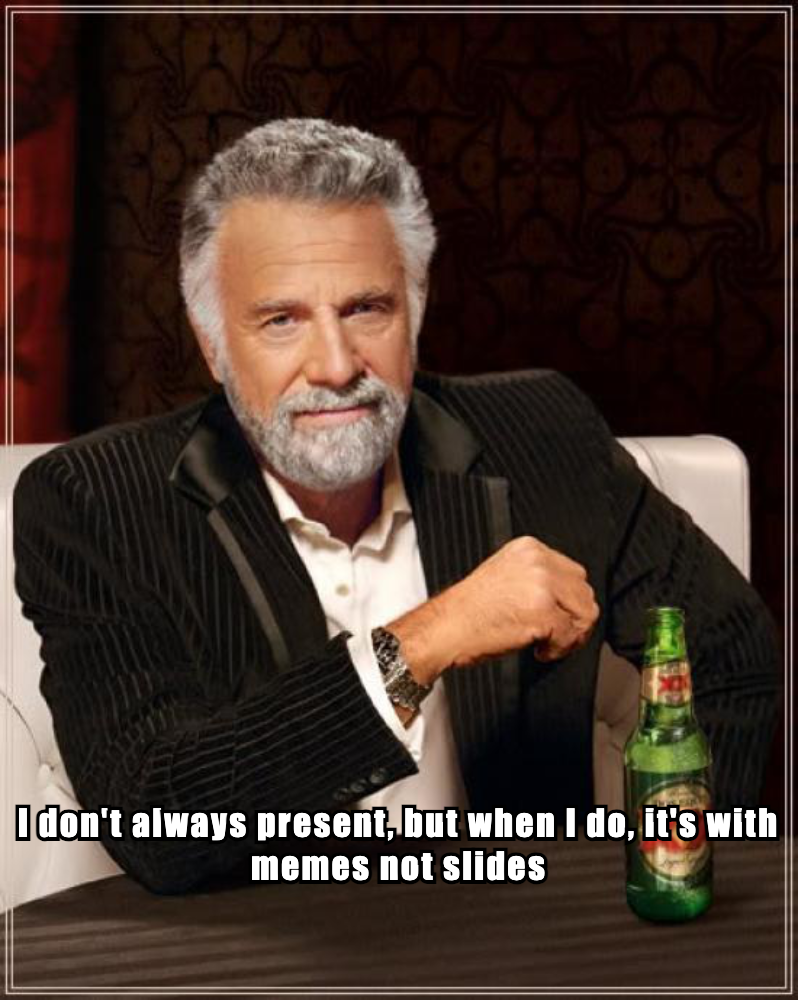

In [89]:
from IPython.display import Image, display
meme_width=600

display(Image(filename='../images/Memes_not_Slides_supermeme_19h43_34.png', width=meme_width))

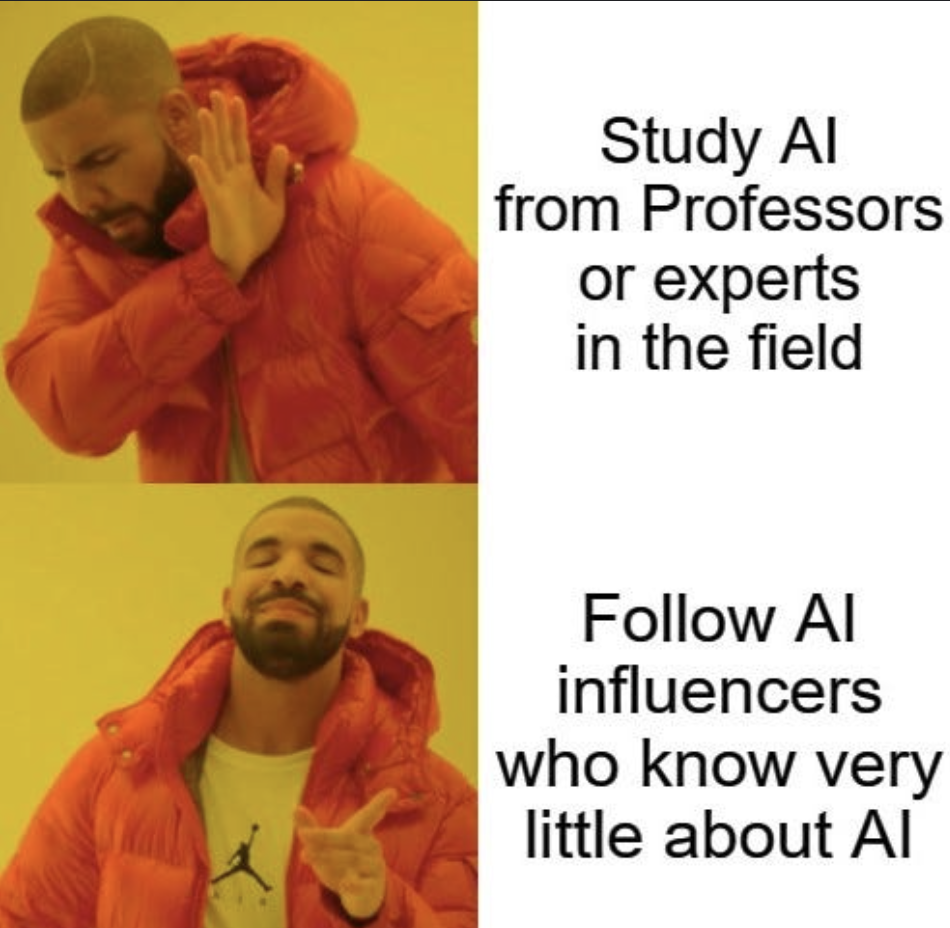

In [90]:
display(Image(filename='../images/AI_Influencer.png', width=meme_width))

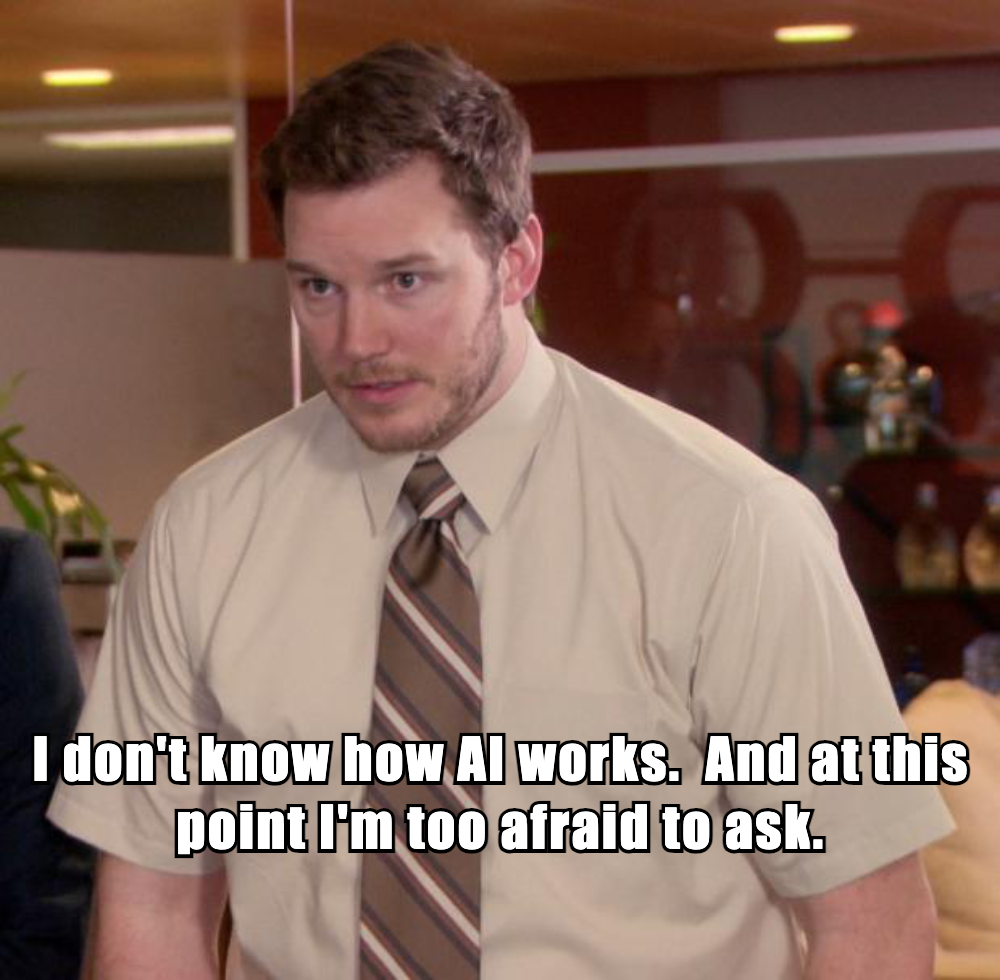

In [91]:
display(Image(filename='../images/I_dont_know.png', width=meme_width))

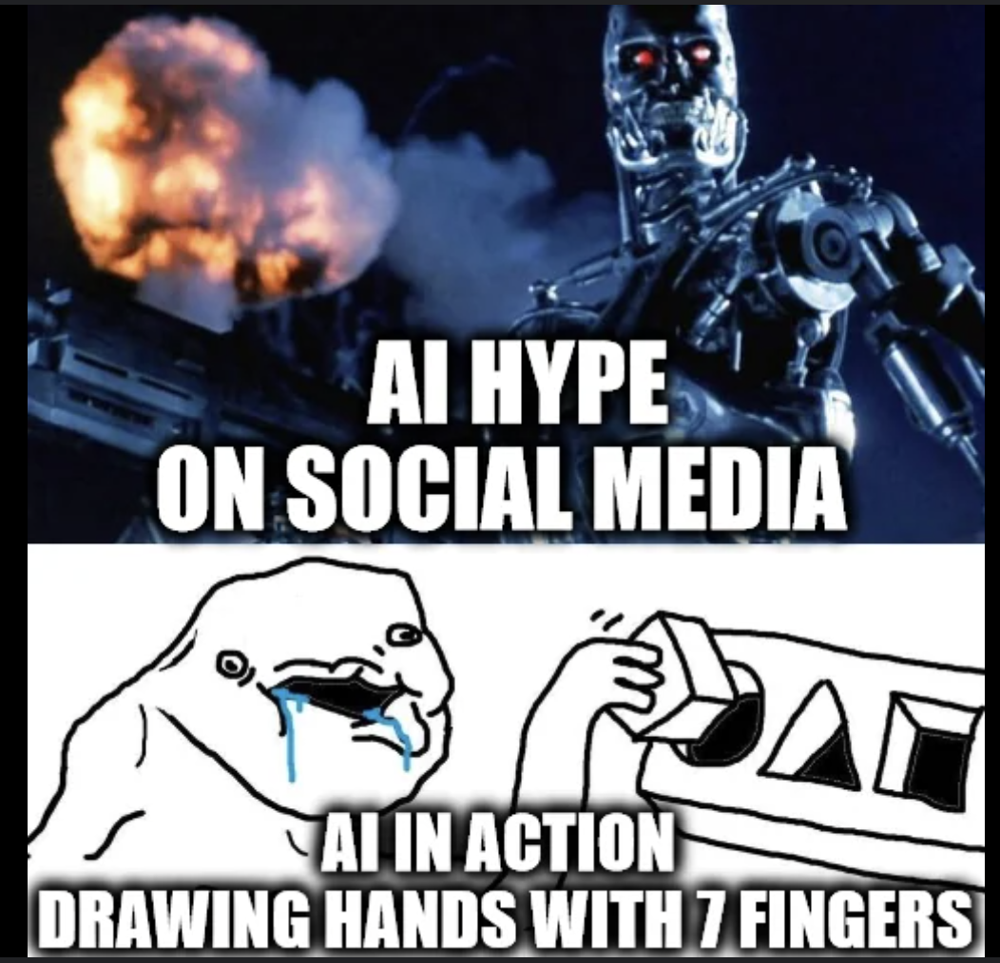

In [92]:
display(Image(filename='../images/AI_Hype.png', width=meme_width))

In [93]:
#display(Image(filename='../images/AI_taking_job.png', width=meme_width))

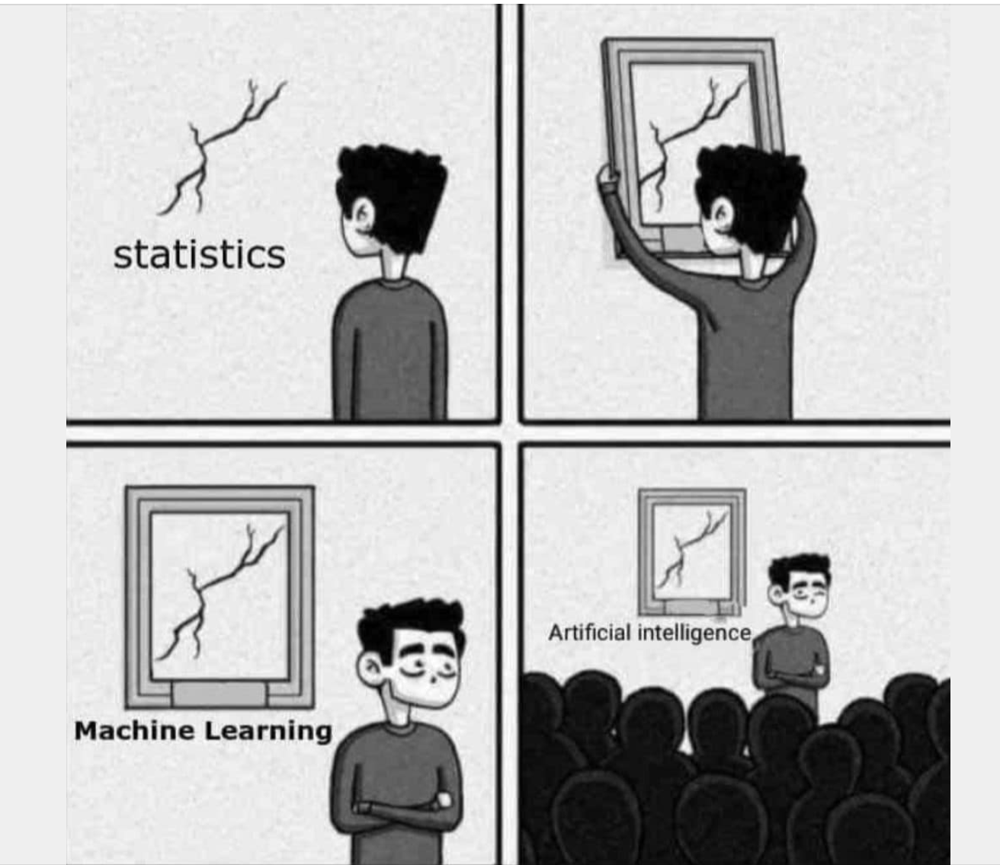

In [94]:
display(Image(filename='../images/ML_is_Statistics.png', width=meme_width))

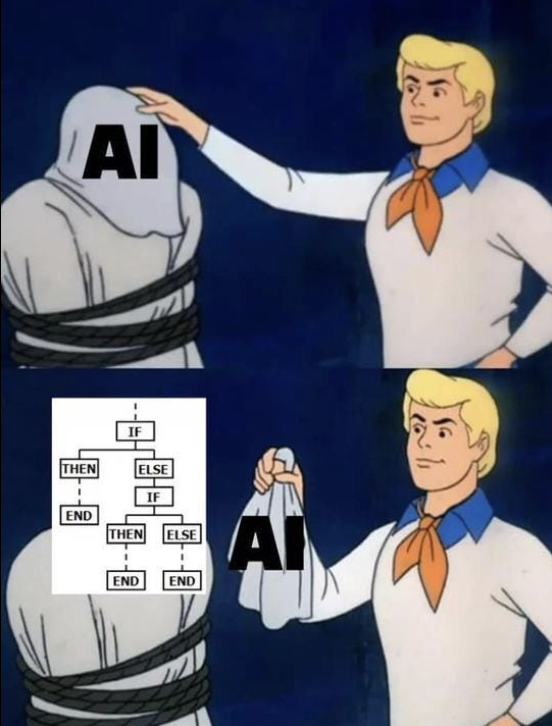

In [55]:
display(Image(filename='../images/AI_is_If_Else.png', width=meme_width))

## Lernen durch Beispiele: Regression

In [2]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd

# 7 Tage, stündliche Werte (168 Stunden)
anzahl_tage = 7
stunden_pro_tag = 24
zeit = np.linspace(0, anzahl_tage * 24 - 1, anzahl_tage * stunden_pro_tag)

# Grundlegende Wachheitskurve (wiederholt sich jeden Tag)
# Jetzt mit Plus statt Minus vor dem Cosinus
basis_wachheit = np.cos((zeit % 24 - 14) * 2 * np.pi / 24)
# Dann auf 0-1 skalieren: f(x) = (x + 1) / 2
basis_wachheit = (basis_wachheit + 1) / 2

# Etwas Rauschen hinzufügen
np.random.seed(42)
wachheit_mit_rauschen = basis_wachheit + np.random.normal(0, 0.1, len(zeit))
# Clipping auf 0-1
wachheit_mit_rauschen = np.clip(wachheit_mit_rauschen, 0, 1)

# DataFrame erstellen mit zusätzlichen Infos für den Hover
df = pd.DataFrame({
    'Zeit': zeit,
    'Wachheit': wachheit_mit_rauschen,
    'Tag': [f'Tag {i+1}' for i in range(anzahl_tage) for _ in range(stunden_pro_tag)],
    'Stunde': [f'{h}:00' for _ in range(anzahl_tage) for h in range(stunden_pro_tag)]
})

# Scatter Plot mit den verrauschten Daten
fig = px.scatter(df, 
                x='Zeit', 
                y='Wachheit',
                hover_data={'Zeit': False,
                          'Tag': True,
                          'Stunde': True,
                          'Wachheit': ':.2f'
                         })

# Ideale Kurve hinzufügen
"""
fig.add_trace(
    go.Scatter(
        x=zeit,
        y=basis_wachheit,
        mode='lines',
        line=dict(dash='dash', color='red'),
        name='Idealer Verlauf',
        opacity=0.5
    )
)
"""

# Layout anpassen
fig.update_layout(
    title='Wachheitsverlauf über mehrere Tage',
    xaxis_title='Zeit',
    yaxis_title='Wachheit (0-1)',
    yaxis_range=[-0.1, 1.1],
    xaxis=dict(
        ticktext=[f'Tag {i+1}' for i in range(anzahl_tage)],
        tickvals=[i*24 + 12 for i in range(anzahl_tage)]
    )
)

# Vertikale Linien für Tagesgrenzen
for tag in range(1, anzahl_tage):
    fig.add_vline(x=tag*24, line_dash="dash", line_color="gray", opacity=0.3)

fig.show()

## Lernen durch Beispiele: Klassifikation

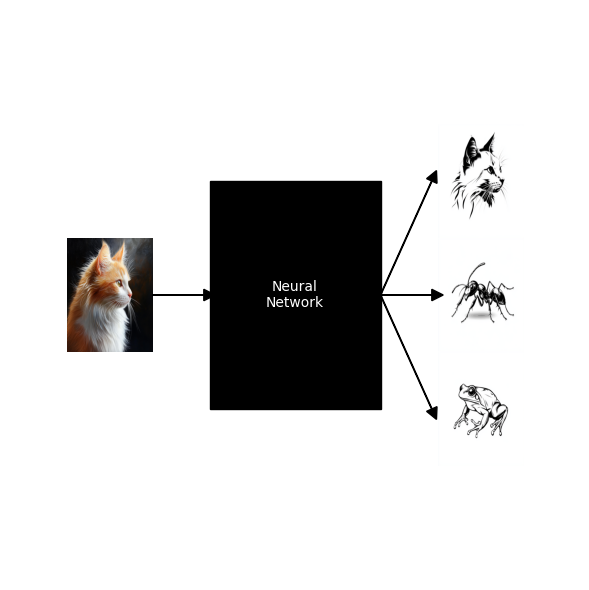

In [3]:
# Figure und Axes erstellen
fig, ax = plt.subplots(figsize=(12, 6))

# Bilder laden
input_img = mpimg.imread("../images/cat.png")
output_imgs = [
    mpimg.imread("../images/cat_icon.png"),
    mpimg.imread("../images/ant_icon.png"),
    mpimg.imread("../images/frog_icon.png")
]

# Input Bild 
ax.imshow(input_img, extent=[0.1, 0.25, 0.4, 0.6])

# Neural Network Box (schwarz)
nn_box = patches.Rectangle((0.35, 0.3), 0.3, 0.4, facecolor='black', edgecolor='black')
ax.add_patch(nn_box)
ax.text(0.5, 0.5, 'Neural\nNetwork', ha='center', va='center', color='white')

# Output Bilder
y_positions = [0.7, 0.5, 0.3]
for i, (y, img) in enumerate(zip(y_positions, output_imgs)):
    ax.imshow(img, extent=[0.75, 0.9, y-0.1, y+0.1])

# Pfeile zeichnen
# Input zu NN
ax.arrow(0.25, 0.5, 0.09, 0, head_width=0.02, head_length=0.02, fc='black', ec='black')

# NN zu Outputs
for y in y_positions:
    ax.arrow(0.65, 0.5, 0.09, y-0.5, head_width=0.02, head_length=0.02, fc='black', ec='black')

# Layout anpassen
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
ax.axis('off')

plt.tight_layout()
plt.show()

## unüberwachtes Lernen: Clustering

In [4]:
import numpy as np
import plotly.express as px
import pandas as pd

# Zufallsgenerator für Reproduzierbarkeit
np.random.seed(42)

# Anzahl der Datenpunkte pro Gruppe
n_points = 100

# "Lerchen" - Früh schlafen, früh aufstehen
lerchen_schlafenszeit = np.random.normal(22, 0.5, n_points)  # Mittelwert 22 Uhr
lerchen_aufwachzeit = np.random.normal(6, 0.5, n_points)     # Mittelwert 6 Uhr

# "Eulen" - Spät schlafen, spät aufstehen
eulen_schlafenszeit = np.random.normal(1, 0.5, n_points)     # Mittelwert 1 Uhr
eulen_aufwachzeit = np.random.normal(9, 0.5, n_points)       # Mittelwert 9 Uhr

# Daten zusammenführen
schlafenszeiten = np.concatenate([lerchen_schlafenszeit, eulen_schlafenszeit])
aufwachzeiten = np.concatenate([lerchen_aufwachzeit, eulen_aufwachzeit])

# Schlafenszeiten nach 24 Uhr auf positive Werte über 24 umrechnen
schlafenszeiten = np.where(schlafenszeiten < 12, schlafenszeiten + 24, schlafenszeiten)

# DataFrame erstellen
df = pd.DataFrame({
    'Schlafenszeit': schlafenszeiten,
    'Aufwachzeit': aufwachzeiten,
    'Wahre_Gruppe': ['Lerche']*n_points + ['Eule']*n_points  # nur zur Visualisierung
})

# Plotly Scatter Plot
fig = px.scatter(df, 
                x='Schlafenszeit', 
                y='Aufwachzeit',
                color='Wahre_Gruppe',
                title='Schlafmuster: Lerchen vs. Eulen',
                labels={'Schlafenszeit': 'Bevorzugte Schlafenszeit (Stunden)',
                       'Aufwachzeit': 'Bevorzugte Aufwachzeit (Stunden)'},
                hover_data=['Schlafenszeit', 'Aufwachzeit'])

# X-Achse anpassen für 24-Stunden-Format
fig.update_xaxes(ticktext=['20:00', '21:00', '22:00', '23:00', '00:00', '01:00', '02:00', '03:00'],
                 tickvals=[20, 21, 22, 23, 24, 25, 26, 27])

# Y-Achse anpassen für 24-Stunden-Format
fig.update_yaxes(ticktext=['04:00', '05:00', '06:00', '07:00', '08:00', '09:00', '10:00', '11:00'],
                 tickvals=[4, 5, 6, 7, 8, 9, 10, 11])

fig.show()

## TLDR

Was kann KI?
- bei genügend Trainingsdaten:
- Regression
- Klassifikation
- Muster finden (z.B. Cluster)


Was kann KI nicht (gut)?
- ohne Daten lernen
- auf "schlechten" Daten lernen

# 1.2 - Das Neuron

## Das biologische Neuron

In [5]:
print("hello world")

hello world


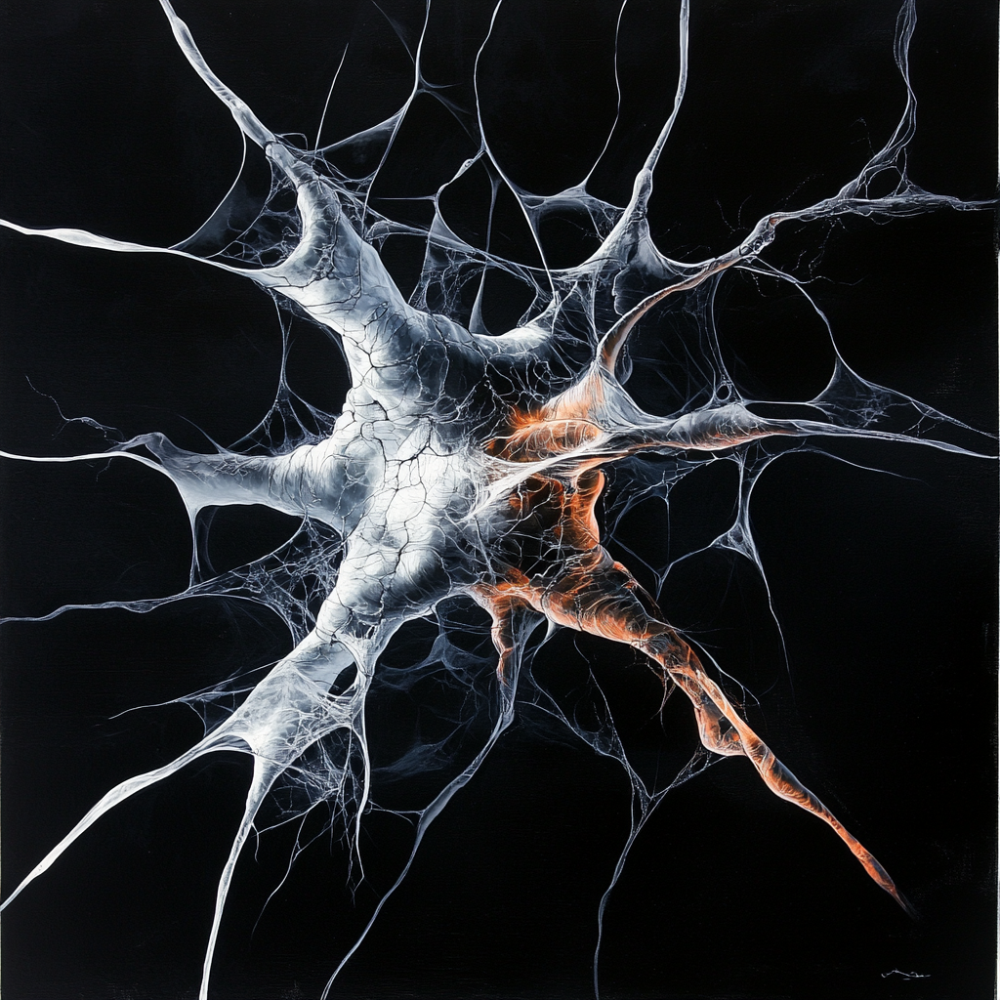

In [6]:
from IPython.display import Image, display

display(Image(filename='../images/neuron.png', width=512))

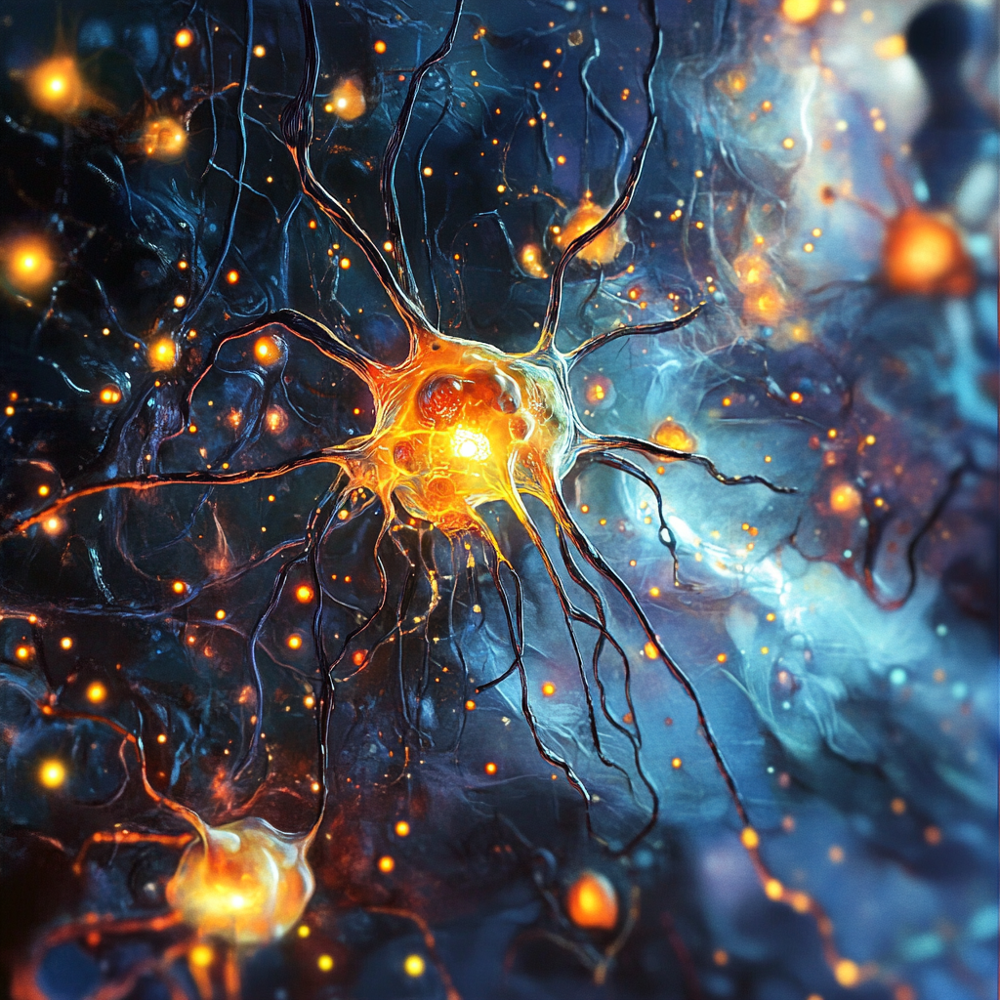

In [7]:
display(Image(filename='../images/neural_network.png', width=512))

## Das künstliche Neuron

In [8]:
# Konstanten
NODE_SIZE = dict(
    input=50,
    neuron=70,
    output=50
)
X_POSITIONS = dict(
    inputs=-2,
    neuron=0,
    output=2
)
COLORS = dict(
    input='rgba(173, 216, 230, 0.7)',  # helleres, transparenteres Blau
    neuron='rgba(144, 238, 144, 0.7)',  # helleres, transparenteres Grün
    output='rgba(250, 128, 114, 0.7)',  # helleres, transparenteres Lachs
    lines='rgba(128, 128, 128, 0.4)',   # transparenteres Grau
    bias='rgba(255, 218, 185, 0.7)'     # Pfirsich für Bias
)

fig = go.Figure()

# Input Neuronen (jetzt mit 4 Inputs inklusive Bias)
input_y = [-1.5, -0.5, 0.5, 1.5]  # Angepasste Y-Positionen für 4 Inputs

# Input Neuronen
for i, y in enumerate(input_y[:-1]):  # Alle außer letzter (Bias)
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['inputs']], 
        y=[y],
        mode='markers+text',
        marker=dict(
            size=NODE_SIZE['input'], 
            color=COLORS['input'],
            line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
        ),
        text=f'x{i}',
        textposition='middle center',
        name='Input' if i == 0 else None,
        showlegend=i == 0
    ))

# Bias Neuron (letzter Input)
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['inputs']], 
    y=[input_y[-1]],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['input'], 
        color=COLORS['bias'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='1',  # Bias Input ist immer 1
    textposition='middle center',
    name='Bias'
))

# Neuron
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['neuron']], 
    y=[0],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['neuron'], 
        color=COLORS['neuron'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='ReLU',
    textposition='middle right',
    name='Neuron'
))

# Output
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['output']], 
    y=[0],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['output'], 
        color=COLORS['output'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='y',
    textposition='middle center',
    name='Output'
))

# Verbindungen mit Gewichten - jetzt mit Text in der Mitte der Linie
for i, y in enumerate(input_y):
    # Berechne Mittelpunkt der Linie für Gewichtstext
    x_mid = (X_POSITIONS['inputs'] + X_POSITIONS['neuron']) / 2
    y_mid = (y + 0) / 2  # Mitte zwischen Input und Neuron
    
    # Gewichtstext
    weight_text = 'b' if i == len(input_y)-1 else f'w{i}'
    
    # Linie
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['inputs']+0.2, X_POSITIONS['neuron']-0.2],
        y=[y, 0],
        mode='lines',
        line=dict(color=COLORS['lines'], width=2),
        showlegend=False
    ))
    
    # Separater Text-Trace für das Gewicht
    fig.add_trace(go.Scatter(
        x=[x_mid],
        y=[y_mid],
        mode='text',
        text=weight_text,
        textposition='middle center',
        showlegend=False
    ))

# Verbindung zum Output
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
    y=[0, 0],
    mode='lines',
    line=dict(color=COLORS['lines'], width=2),
    showlegend=False
))

# Formel 
formula = 'y = ReLU(Σ wᵢxᵢ + b)'

fig.add_annotation(
    x=X_POSITIONS['neuron'], 
    y=2,
    text=formula,
    showarrow=False,
    font=dict(size=14, family='Computer Modern'),
    bgcolor='rgba(255, 255, 255, 0.9)',
    bordercolor='rgba(0, 0, 0, 0.3)',
    borderwidth=1,
    borderpad=10
)

# Layout
fig.update_layout(
    title=dict(
        text='Einzelnes Neuron mit gewichteter Summe und ReLU Aktivierung',
        x=0.5,
        y=0.95,
        font=dict(size=16)
    ),
    showlegend=True,
    xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
    yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
    plot_bgcolor='white',
    width=1000,
    height=600,
    margin=dict(t=100, b=50)
)

fig.show()

## Datenbeispiel

In [9]:
# Simulierte "Trainingsdaten": Gemessene Wachheit von Schülern
np.random.seed(42)  # Für reproduzierbare Ergebnisse
n_samples = 40

# Generiere realistische Trainingsdaten
times_early = np.random.uniform(5, 8, n_samples // 2)  # Frühe Morgenstunden
times_late = np.random.uniform(8, 12, n_samples // 2)   # Späte Morgenstunden

# Wachheitswerte mit mehr Überlappung und Variation
wakefulness_early = np.random.normal(0.3, 0.2, n_samples // 2)  # Erhöhter Mittelwert und Standardabweichung
wakefulness_late = np.random.normal(0.7, 0.2, n_samples // 2)   # Verringerter Mittelwert und erhöhte Standardabweichung

# Füge einige "Ausreißer" hinzu
outliers_early_awake = np.random.normal(0.7, 0.1, 2)  # Einige frühe aber wache Schüler
outliers_late_sleepy = np.random.normal(0.3, 0.1, 2)  # Einige späte aber müde Schüler

# Kombiniere die Daten inklusive Ausreißer
times_data = np.concatenate([times_early, times_late, 
                          np.random.uniform(5, 8, 3),  # Zeiten für frühe Ausreißer
                          np.random.uniform(8, 12, 3)]) # Zeiten für späte Ausreißer
wakefulness_data = np.concatenate([wakefulness_early, wakefulness_late,
                                outliers_early_awake, outliers_late_sleepy])

# Begrenze die Werte auf [0,1]
wakefulness_data = np.clip(wakefulness_data, 0, 1)

# Erstelle Plot
fig = go.Figure()

# Füge nur die Datenpunkte hinzu
fig.add_trace(
   go.Scatter(x=times_data, y=wakefulness_data,
              mode='markers',
              name='Gemessene Wachheit',
              marker=dict(size=10, color='blue', opacity=0.5))
)

# Update Layout
fig.update_layout(
   height=500,
   title_text="Gemessene Schüler-Wachheit zu verschiedenen Uhrzeiten",
   xaxis_title="Uhrzeit",
   yaxis_title="Wachheit (0=schläft, 1=wach)",
   xaxis=dict(range=[5, 12]),
   yaxis=dict(range=[-0.1, 1.1]),
   showlegend=True,
   hovermode='x unified'
)

fig.show()

## Nur ein Input Neuron, kein Gewicht, kein Bias

In [10]:
# Konstanten
NODE_SIZE = dict(
   input=50,
   neuron=70,
   output=50
)
X_POSITIONS = dict(
   input=-2,
   neuron=0,
   output=2
)
COLORS = dict(
   input='rgba(173, 216, 230, 0.7)',  # helleres, transparenteres Blau
   neuron='rgba(144, 238, 144, 0.7)',  # helleres, transparenteres Grün
   output='rgba(250, 128, 114, 0.7)',  # helleres, transparenteres Lachs
   lines='rgba(128, 128, 128, 0.4)'    # transparenteres Grau
)

fig = go.Figure()

# Input Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='x',
   textposition='middle center',
   name='Input'
))

# Mittleres Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']], 
   y=[0],
   mode='markers',
   marker=dict(
       size=NODE_SIZE['neuron'], 
       color=COLORS['neuron'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   name='Neuron'
))

# Output Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['output']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['output'], 
       color=COLORS['output'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='y',
   textposition='middle center',
   name='Output'
))

# Verbindungen
# Input zu Neuron
x_mid1 = (X_POSITIONS['input'] + X_POSITIONS['neuron']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Gewichtstext w=1
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.3],  # Leicht über der Linie
   mode='text',
   text='w=1',
   textposition='middle center',
   showlegend=False
))

# Neuron zu Output
x_mid2 = (X_POSITIONS['neuron'] + X_POSITIONS['output']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Formel 
formula = 'y = x'

fig.add_annotation(
   x=0, 
   y=2,
   text=formula,
   showarrow=False,
   font=dict(size=14, family='Computer Modern'),
   bgcolor='rgba(255, 255, 255, 0.9)',
   bordercolor='rgba(0, 0, 0, 0.3)',
   borderwidth=1,
   borderpad=10
)

# Layout
fig.update_layout(
   title=dict(
       text='Einzelnes Input-Neuron mit Gewicht 1',
       x=0.5,
       y=0.95,
       font=dict(size=16)
   ),
   showlegend=True,
   xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
   yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
   plot_bgcolor='white',
   width=1000,
   height=600,
   margin=dict(t=100, b=50)
)

fig.show()

In [11]:
# Lineare Funktion durch den Nullpunkt
times_smooth = np.linspace(0, 12, 100)
linear_output = times_smooth * 1  # y = x (Steigung 1)

# Erstelle Plot
fig = go.Figure()

# Datenpunkte
fig.add_trace(
   go.Scatter(x=times_data, y=wakefulness_data,
              mode='markers',
              name='Gemessene Wachheit',
              marker=dict(size=10, color='blue', opacity=0.5))
)

# Lineare Funktion
fig.add_trace(
   go.Scatter(x=times_smooth, y=linear_output,
              name='Lineare Funktion (y = x)',
              line=dict(color='red', width=3))
)

# Update Layout
fig.update_layout(
   height=500,
   title_text="Einfaches Neuron: Lineare Funktion durch den Nullpunkt (Steigung 1)",
   xaxis_title="Uhrzeit",
   yaxis_title="Output",
   showlegend=True,
   hovermode='x unified'
)

# Update Achsen
fig.update_xaxes(range=[0, 12])
fig.update_yaxes(range=[-0.1, 1.1])

fig.show()

## Nur ein input Neuron mit Gewicht, kein Bias

In [12]:
# Konstanten
NODE_SIZE = dict(
   input=50,
   neuron=70,
   output=50
)
X_POSITIONS = dict(
   input=-2,
   neuron=0,
   output=2
)
COLORS = dict(
   input='rgba(173, 216, 230, 0.7)',  # helleres, transparenteres Blau
   neuron='rgba(144, 238, 144, 0.7)',  # helleres, transparenteres Grün
   output='rgba(250, 128, 114, 0.7)',  # helleres, transparenteres Lachs
   lines='rgba(128, 128, 128, 0.4)'    # transparenteres Grau
)

fig = go.Figure()

# Input Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='x',
   textposition='middle center',
   name='Input'
))

# Mittleres Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']], 
   y=[0],
   mode='markers',
   marker=dict(
       size=NODE_SIZE['neuron'], 
       color=COLORS['neuron'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   name='Neuron'
))

# Output Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['output']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['output'], 
       color=COLORS['output'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='y',
   textposition='middle center',
   name='Output'
))

# Verbindungen
# Input zu Neuron
x_mid1 = (X_POSITIONS['input'] + X_POSITIONS['neuron']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Gewichtstext w=0.1 in fett
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.3],  # Leicht über der Linie
   mode='text',
   text='<b>w=0.1</b>',  # HTML bold tag für fetten Text
   textposition='middle center',
   showlegend=False
))

# Neuron zu Output
x_mid2 = (X_POSITIONS['neuron'] + X_POSITIONS['output']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Formel 
formula = 'y = 0.1x'  # Angepasste Formel

fig.add_annotation(
   x=0, 
   y=2,
   text=formula,
   showarrow=False,
   font=dict(size=14, family='Computer Modern'),
   bgcolor='rgba(255, 255, 255, 0.9)',
   bordercolor='rgba(0, 0, 0, 0.3)',
   borderwidth=1,
   borderpad=10
)

# Layout
fig.update_layout(
   title=dict(
       text='Einzelnes Input-Neuron mit Gewicht 0.1',
       x=0.5,
       y=0.95,
       font=dict(size=16)
   ),
   showlegend=True,
   xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
   yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
   plot_bgcolor='white',
   width=1000,
   height=600,
   margin=dict(t=100, b=50)
)

fig.show()

In [13]:
# Lineare Funktion durch den Nullpunkt
times_smooth = np.linspace(0, 12, 100)
linear_output = times_smooth * 0.1  # y = 0.1x

# Erstelle Plot
fig = go.Figure()

# Datenpunkte
fig.add_trace(
    go.Scatter(x=times_data, y=wakefulness_data,
               mode='markers',
               name='Gemessene Wachheit',
               marker=dict(size=10, color='blue', opacity=0.5))
)

# Lineare Funktion
fig.add_trace(
    go.Scatter(x=times_smooth, y=linear_output,
               name='Lineare Funktion (y = 0.1x)',
               line=dict(color='red', width=3))
)

# Update Layout
fig.update_layout(
    height=500,
    title_text="Einfaches Neuron: Lineare Funktion durch den Nullpunkt",
    xaxis_title="Uhrzeit",
    yaxis_title="Output",
    showlegend=True,
    hovermode='x unified'
)

# Update Achsen
fig.update_xaxes(range=[0, 12])
fig.update_yaxes(range=[-0.1, 1.1])

fig.show()

## Nur ein Input Neuron mit Gewicht und Bias

In [14]:
# Konstanten
NODE_SIZE = dict(
   input=50,
   neuron=70,
   output=50
)
X_POSITIONS = dict(
   input=-2,
   neuron=0,
   output=2
)
COLORS = dict(
   input='rgba(173, 216, 230, 0.7)',  # helleres, transparenteres Blau
   neuron='rgba(144, 238, 144, 0.7)',  # helleres, transparenteres Grün
   output='rgba(250, 128, 114, 0.7)',  # helleres, transparenteres Lachs
   lines='rgba(128, 128, 128, 0.4)',   # transparenteres Grau
   bias='rgba(255, 218, 185, 0.7)'     # Pfirsich für Bias
)

fig = go.Figure()

# Input Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='x',
   textposition='middle center',
   name='Input'
))

# Bias Neuron - jetzt oben
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[1],  # Oberhalb des Input Neurons
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['bias'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='1',
   textposition='middle center',
   name='Bias'
))

# Mittleres Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']], 
   y=[0],
   mode='markers',
   marker=dict(
       size=NODE_SIZE['neuron'], 
       color=COLORS['neuron'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   name='Neuron'
))

# Output Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['output']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['output'], 
       color=COLORS['output'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='y',
   textposition='middle center',
   name='Output'
))

# Verbindungen
# Input zu Neuron
x_mid1 = (X_POSITIONS['input'] + X_POSITIONS['neuron']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Gewichtstext w=0.1
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.3],  # Leicht über der Linie
   mode='text',
   text='w=0.1',
   textposition='middle center',
   showlegend=False
))

# Bias zu Neuron - jetzt von oben
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[1, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Bias text
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.7],  # Unter der Bias-Linie
   mode='text',
   text='<b>b=-0.5</b>',  # Fett
   textposition='middle center',
   showlegend=False
))

# Neuron zu Output
x_mid2 = (X_POSITIONS['neuron'] + X_POSITIONS['output']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Formel 
formula = 'y = 0.1x - 0.5'

fig.add_annotation(
   x=0, 
   y=2,
   text=formula,
   showarrow=False,
   font=dict(size=14, family='Computer Modern'),
   bgcolor='rgba(255, 255, 255, 0.9)',
   bordercolor='rgba(0, 0, 0, 0.3)',
   borderwidth=1,
   borderpad=10
)

# Layout
fig.update_layout(
   title=dict(
       text='Einzelnes Input-Neuron mit Gewicht 0.1 und Bias -0.5',
       x=0.5,
       y=0.95,
       font=dict(size=16)
   ),
   showlegend=True,
   xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
   yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
   plot_bgcolor='white',
   width=1000,
   height=600,
   margin=dict(t=100, b=50)
)

fig.show()

In [15]:
# Lineare Funktion mit Bias
times_smooth = np.linspace(0, 12, 100)
bias = -0.5  # Bias als Verschiebung nach unten
linear_output = times_smooth * 0.1 + bias  # y = 0.1x - 0.5

# Erstelle Plot
fig = go.Figure()

# Datenpunkte
fig.add_trace(
   go.Scatter(x=times_data, y=wakefulness_data,
              mode='markers',
              name='Gemessene Wachheit',
              marker=dict(size=10, color='blue', opacity=0.5))
)

# Lineare Funktion
fig.add_trace(
   go.Scatter(x=times_smooth, y=linear_output,
              name=f'Lineare Funktion (y = 0.1x {bias:+.1f})',
              line=dict(color='red', width=3))
)

# Bias Visualisierung - Punkt auf y-Achse
fig.add_trace(
   go.Scatter(x=[0], y=[bias],
              mode='markers',
              name='Bias',
              marker=dict(size=15, color='green', symbol='x'))
)

# Update Layout
fig.update_layout(
   height=500,
   title_text="Einfaches Neuron: Lineare Funktion mit Bias",
   xaxis_title="Uhrzeit",
   yaxis_title="Output",
   showlegend=True,
   hovermode='x unified'
)

# Update Achsen
fig.update_xaxes(range=[0, 12])
fig.update_yaxes(range=[-0.6, 1.1])  # Angepasst um Bias zu zeigen

fig.show()

## Aktivierungsfunktionen - Part I: eine Dimension

In [16]:
# Konstanten
NODE_SIZE = dict(
   input=50,
   neuron=70,
   output=50
)
X_POSITIONS = dict(
   input=-2,
   neuron=0,
   output=2
)
COLORS = dict(
   input='rgba(173, 216, 230, 0.7)',  # helleres, transparenteres Blau
   neuron='rgba(144, 238, 144, 0.7)',  # helleres, transparenteres Grün
   output='rgba(250, 128, 114, 0.7)',  # helleres, transparenteres Lachs
   lines='rgba(128, 128, 128, 0.4)',   # transparenteres Grau
   bias='rgba(255, 218, 185, 0.7)'     # Pfirsich für Bias
)

fig = go.Figure()

# Input Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='x',
   textposition='middle center',
   name='Input'
))

# Bias Neuron - oben
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']], 
   y=[1],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'], 
       color=COLORS['bias'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='1',
   textposition='middle center',
   name='Bias'
))

# Mittleres Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['neuron'], 
       color=COLORS['neuron'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='<b>ReLU</b>',  # Fett geschrieben
   textposition='middle center',
   name='Neuron'
))

# Output Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['output']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['output'], 
       color=COLORS['output'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='y',
   textposition='middle center',
   name='Output'
))

# Verbindungen
# Input zu Neuron
x_mid1 = (X_POSITIONS['input'] + X_POSITIONS['neuron']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Gewichtstext w=0.1
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.3],
   mode='text',
   text='w=0.1',
   textposition='middle center',
   showlegend=False
))

# Bias zu Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['input']+0.2, X_POSITIONS['neuron']-0.2],
   y=[1, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Bias text
fig.add_trace(go.Scatter(
   x=[x_mid1],
   y=[0.7],
   mode='text',
   text='b=-0.5',  # Nicht mehr fett
   textposition='middle center',
   showlegend=False
))

# Neuron zu Output
x_mid2 = (X_POSITIONS['neuron'] + X_POSITIONS['output']) / 2
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Formel 
formula = 'y = ReLU(0.1x - 0.5)'  # Angepasste Formel mit ReLU

fig.add_annotation(
   x=0, 
   y=2,
   text=formula,
   showarrow=False,
   font=dict(size=14, family='Computer Modern'),
   bgcolor='rgba(255, 255, 255, 0.9)',
   bordercolor='rgba(0, 0, 0, 0.3)',
   borderwidth=1,
   borderpad=10
)

# Layout
fig.update_layout(
   title=dict(
       text='Einzelnes Input-Neuron mit ReLU-Aktivierung',
       x=0.5,
       y=0.95,
       font=dict(size=16)
   ),
   showlegend=True,
   xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
   yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
   plot_bgcolor='white',
   width=1000,
   height=600,
   margin=dict(t=100, b=50)
)

fig.show()

In [17]:
import plotly.graph_objects as go
import plotly.subplots as sp
import numpy as np

x = np.linspace(-5, 5, 200)

relu = np.maximum(0, x)
sigmoid = 1 / (1 + np.exp(-x))
tanh = np.tanh(x)

fig = sp.make_subplots(rows=1, cols=3, subplot_titles=('ReLU', 'Sigmoid', 'Tanh'))

fig.add_trace(
    go.Scatter(x=x, y=relu, name='ReLU', line=dict(color='#1f77b4')),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=x, y=sigmoid, name='Sigmoid', line=dict(color='#2ca02c')),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(x=x, y=tanh, name='Tanh', line=dict(color='#ff7f0e')),
    row=1, col=3
)

fig.update_layout(
    showlegend=True,
    title_text="Aktivierungsfunktionen im Vergleich",
    height=400,
    template='plotly_white',
    hovermode='x'
)

fig.update_xaxes(zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey')
fig.update_yaxes(zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey')

fig.show()

In [18]:
import numpy as np
import plotly.graph_objects as go



# Glatte Kurve für die Aktivierungsfunktionen
times_smooth = np.linspace(5, 12, 100)

# Aktivierungsfunktionen mit Bias von -0.5
def relu_like(x):
    return np.clip((x - 8) / 4, +0.1, 1)  # ReLU mit Bias -0.5

def sigmoid_like(x):
    return 1 / (1 + np.exp(-(x - 8.5) * 2)) + 0.1  # Sigmoid mit Bias -0.5

# Erstelle Plot
fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=('ReLU-artige Aktivierung: "Harte Grenze"',
                                  'Sigmoid Aktivierung: "Sanfter Übergang"'))

# Plot für ReLU
fig.add_trace(
    go.Scatter(x=times_data, y=wakefulness_data,
               mode='markers',
               name='Gemessene Wachheit',
               marker=dict(size=10, color='blue', opacity=0.5)),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=times_smooth, y=relu_like(times_smooth),
               name='ReLU Entscheidungsgrenze',
               line=dict(color='green', width=3)),
    row=1, col=1
)

# Plot für Sigmoid
fig.add_trace(
    go.Scatter(x=times_data, y=wakefulness_data,
               mode='markers',
               name='Gemessene Wachheit',
               marker=dict(size=10, color='blue', opacity=0.5),
               showlegend=False),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(x=times_smooth, y=sigmoid_like(times_smooth),
               name='Sigmoid Entscheidungsgrenze',
               line=dict(color='red', width=3)),
    row=1, col=2
)

# Update Layout
fig.update_layout(
    height=500,
    title_text="Neuron lernt: 'Ist der Schüler wach?' basierend auf der Uhrzeit",
    showlegend=True,
    hovermode='x unified'
)

# Update Achsen
for i in [1, 2]:
    fig.update_xaxes(title_text="Uhrzeit", range=[5, 12], row=1, col=i)
    fig.update_yaxes(title_text="Wachheit (0=schläft, 1=wach)", 
                     range=[-0.6, 1.1], row=1, col=i)

fig.show()

## Aktivierungsfunktion Part II: 2 Dimensionen

In [19]:
# Kombiniere die existierenden Daten
times_data = np.concatenate([times_early, times_late])
wakefulness_data = np.concatenate([np.concatenate([wakefulness_early, outliers_early_awake]), 
                                 np.concatenate([wakefulness_late, outliers_late_sleepy])])

# Generiere passende Schlafstunden
# Mehr Schlaf korreliert mit höherer Wachheit und späterem Aufstehen
sleep_hours = np.zeros_like(times_data)
for i in range(len(times_data)):
    base_sleep = 7  # Durchschnittliche Schlafstunden
    wake_effect = (wakefulness_data[i] - 0.5) * 2  # Effekt der Wachheit (-1 bis +1)
    time_effect = (times_data[i] - 8.5) / 4  # Effekt der Uhrzeit (-1 bis +1)
    
    # Kombiniere die Effekte mit etwas Zufälligkeit
    sleep_hours[i] = base_sleep + wake_effect + time_effect + np.random.normal(0, 0.5)

# Stelle sicher, dass die Schlafstunden in einem realistischen Bereich liegen
sleep_hours = np.clip(sleep_hours, 4, 10)

# Erstelle 3D Plot
fig = go.Figure(data=[
    go.Scatter3d(
        x=times_data,
        y=sleep_hours,
        z=wakefulness_data,
        mode='markers',
        marker=dict(
            size=8,
            color=wakefulness_data,
            colorscale='RdYlGn',
            opacity=0.8,
            showscale=True,
            colorbar=dict(title="Wachheit")
        ),
        hovertemplate='Zeit: %{x:.1f}h<br>Schlaf: %{y:.1f}h<br>Wachheit: %{z:.2f}<extra></extra>'
    )
])

# Layout aktualisieren
fig.update_layout(
    height=800,
    title="3D: Schüler-Wachheit abhängig von Uhrzeit und Schlafstunden",
    scene=dict(
        xaxis_title="Stunden seit Mitternacht",
        yaxis_title="Schlafstunden",
        zaxis_title="Wachheit",
        xaxis=dict(range=[5, 12], autorange="reversed"),  # Umgekehrte Achse
        yaxis=dict(range=[4, 10]),
        zaxis=dict(range=[0, 1]),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=1.2),
            up=dict(x=0, y=0, z=1)
        )
    ),
)

fig.show()

In [20]:
# Verwende die existierenden Datenpunkte und Schlafstunden

# Erstelle Gitter für die Aktivierungsfunktionen
x = np.linspace(5, 12, 50)
y = np.linspace(4, 10, 50)
X, Y = np.meshgrid(x, y)

# Die ursprünglichen Aktivierungsfunktionen
def relu_activation(time, sleep):
    return np.clip(0.3 * (time - 7)/5 + 0.7 * (sleep - 6)/4, 0, 1)

def sigmoid_activation(time, sleep):
    return 1 / (1 + np.exp(-2 * (0.3 * (time - 7.5)/5 + 0.7 * (sleep - 7)/4)))

# Berechne Z-Werte für beide Aktivierungsfunktionen
Z_relu = relu_activation(X, Y)
Z_sigmoid = sigmoid_activation(X, Y)

# Erstelle zwei Subplots
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{'type': 'scene'}, {'type': 'scene'}]],
    subplot_titles=("ReLU Aktivierung", "Sigmoid Aktivierung")
)

# ReLU Plot
fig.add_trace(
    go.Scatter3d(
        x=times_data,
        y=sleep_hours,
        z=wakefulness_data,
        mode='markers',
        marker=dict(
            size=8,
            color=wakefulness_data,
            colorscale='RdYlGn',
            opacity=0.8,
            showscale=True,
            colorbar=dict(title="Wachheit")
        ),
        name='Datenpunkte',
        hovertemplate='Zeit: %{x:.1f}h<br>Schlaf: %{y:.1f}h<br>Wachheit: %{z:.2f}<extra></extra>'
    ),
    row=1, col=1
)

fig.add_trace(
    go.Surface(
        x=X, y=Y, z=Z_relu,
        opacity=0.7,
        colorscale='RdYlGn',
        name='ReLU',
        showscale=False
    ),
    row=1, col=1
)

# Sigmoid Plot
fig.add_trace(
    go.Scatter3d(
        x=times_data,
        y=sleep_hours,
        z=wakefulness_data,
        mode='markers',
        marker=dict(
            size=8,
            color=wakefulness_data,
            colorscale='RdYlGn',
            opacity=0.8,
            showscale=False
        ),
        name='Datenpunkte',
        showlegend=False,
        hovertemplate='Zeit: %{x:.1f}h<br>Schlaf: %{y:.1f}h<br>Wachheit: %{z:.2f}<extra></extra>'
    ),
    row=1, col=2
)

fig.add_trace(
    go.Surface(
        x=X, y=Y, z=Z_sigmoid,
        opacity=0.7,
        colorscale='RdYlGn',
        name='Sigmoid',
        showscale=False
    ),
    row=1, col=2
)

# Update Layout
fig.update_layout(
    height=800, width=1200,
    title_text="3D Aktivierungsfunktionen mit Trainingsdaten",
    showlegend=True,
)

# Update beide 3D-Szenen
camera = dict(
    eye=dict(x=1.5, y=1.5, z=1.2),
    up=dict(x=0, y=0, z=1)
)

# Update die Szenen mit umgekehrter x-Achse
fig.update_scenes(
    camera=camera,
    xaxis_title="Stunden seit Mitternacht",
    yaxis_title="Schlafstunden",
    zaxis_title="Wachheit",
    xaxis=dict(range=[5, 12], autorange="reversed"),
    yaxis=dict(range=[4, 10]),
    zaxis=dict(range=[0, 1])
)

fig.show()

## TLDR Neuron Revisited

In [78]:
# Konstanten
NODE_SIZE = dict(
    input=50,
    neuron=70,
    output=50
)
X_POSITIONS = dict(
    inputs=-2,
    neuron=0,
    output=2
)
COLORS = dict(
    input='rgba(173, 216, 230, 0.7)',
    neuron='rgba(144, 238, 144, 0.7)',
    output='rgba(250, 128, 114, 0.7)',
    lines='rgba(128, 128, 128, 0.4)',
    bias='rgba(255, 218, 185, 0.7)'
)

fig = go.Figure()

# Input Neuronen (2 Inputs + Bias)
input_y = [-1, 0, 1]  # Y-Positionen für 2 Inputs + Bias

# Input Neuronen
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['inputs']], 
    y=[input_y[0]],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['input'], 
        color=COLORS['input'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='Uhrzeit',
    textposition='middle left',
    name='Input'
))

fig.add_trace(go.Scatter(
    x=[X_POSITIONS['inputs']], 
    y=[input_y[1]],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['input'], 
        color=COLORS['input'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='Schlafstunden',
    textposition='middle left',
    showlegend=False
))

# Bias Neuron
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['inputs']], 
    y=[input_y[2]],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['input'], 
        color=COLORS['bias'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='1',
    textposition='middle center',
    name='Bias'
))

# Neuron
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['neuron']], 
    y=[0],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['neuron'], 
        color=COLORS['neuron'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='ReLU',
    textposition='middle right',
    name='Neuron'
))

# Output
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['output']], 
    y=[0],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['output'], 
        color=COLORS['output'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='Wachheit',
    textposition='middle right',
    name='Output'
))

# Verbindungen mit Gewichten
weights = ['0.06', '0.175', '-1.47']  # Die berechneten Gewichte

# Formel aktualisieren
formula = 'Wachheit = ReLU(0.06 × Uhrzeit + 0.175 × Schlafstunden - 1.47)'

for i, (y, w) in enumerate(zip(input_y, weights)):
    x_mid = (X_POSITIONS['inputs'] + X_POSITIONS['neuron']) / 2
    y_mid = (y + 0) / 2

    # Linie
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['inputs']+0.2, X_POSITIONS['neuron']-0.2],
        y=[y, 0],
        mode='lines',
        line=dict(color=COLORS['lines'], width=2),
        showlegend=False
    ))

    # Gewicht
    fig.add_trace(go.Scatter(
        x=[x_mid],
        y=[y_mid],
        mode='text',
        text=w,
        textposition='middle center',
        showlegend=False
    ))

# Verbindung zum Output
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
    y=[0, 0],
    mode='lines',
    line=dict(color=COLORS['lines'], width=2),
    showlegend=False
))

fig.add_annotation(
    x=X_POSITIONS['neuron'], 
    y=2,
    text=formula,
    showarrow=False,
    font=dict(size=14),
    bgcolor='rgba(255, 255, 255, 0.9)',
    bordercolor='rgba(0, 0, 0, 0.3)',
    borderwidth=1,
    borderpad=10
)

# Layout
fig.update_layout(
    title=dict(
        text='Neuron zur Wachheitsvorhersage',
        x=0.5,
        y=0.95,
        font=dict(size=16)
    ),
    showlegend=True,
    xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
    yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
    plot_bgcolor='white',
    width=1000,
    height=600,
    margin=dict(t=100, b=50)
)

fig.show()

In [22]:
data = {
   'Beschreibung': ['Früh + wenig Schlaf', 'Früh + viel Schlaf', 'Spät + wenig Schlaf', 'Spät + viel Schlaf', 'Durchschnittlich'],
   'Uhrzeit': [6, 6, 10, 10, 8],
   'Schlafstunden': [5, 9, 5, 9, 7],
   'Berechnung': [
       '0.06 × 6 + 0.175 × 5 - 1.47',
       '0.06 × 6 + 0.175 × 9 - 1.47',
       '0.06 × 10 + 0.175 × 5 - 1.47',
       '0.06 × 10 + 0.175 × 9 - 1.47',
       '0.06 × 8 + 0.175 × 7 - 1.47'
   ],
   'Gewichtete_Summe': [
       0.06 * 6 + 0.175 * 5 - 1.47,  # -0.115
       0.06 * 6 + 0.175 * 9 - 1.47,  # 0.585
       0.06 * 10 + 0.175 * 5 - 1.47, # 0.125
       0.06 * 10 + 0.175 * 9 - 1.47, # 0.825
       0.06 * 8 + 0.175 * 7 - 1.47   # 0.275
   ],
   'Nach_ReLU': [
       max(0, 0.06 * 6 + 0.175 * 5 - 1.47),  # 0.0
       max(0, 0.06 * 6 + 0.175 * 9 - 1.47),  # 0.585
       max(0, 0.06 * 10 + 0.175 * 5 - 1.47), # 0.125
       max(0, 0.06 * 10 + 0.175 * 9 - 1.47), # 0.825
       max(0, 0.06 * 8 + 0.175 * 7 - 1.47)   # 0.275
   ]
}

df = pd.DataFrame(data).sort_values(by="Gewichtete_Summe")

df

,Beschreibung,Uhrzeit,Schlafstunden,Berechnung,Gewichtete_Summe,Nach_ReLU
0,Früh + wenig Schlaf,6,5,0.06 × 6 + 0.175 × 5 - 1.47,-0.235,0.000
2,Spät + wenig Schlaf,10,5,0.06 × 10 + 0.175 × 5 - 1.47,0.005,0.005
4,Durchschnittlich,8,7,0.06 × 8 + 0.175 × 7 - 1.47,0.235,0.235
1,Früh + viel Schlaf,6,9,0.06 × 6 + 0.175 × 9 - 1.47,0.465,0.465
3,Spät + viel Schlaf,10,9,0.06 × 10 + 0.175 × 9 - 1.47,0.705,0.705


# 1.3 - Das Netz

## von Regression zur Klassifikation

In [23]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Ihre originalen Datenpunkte
np.random.seed(42)
n_samples = 40

times_early = np.random.uniform(5, 8, n_samples // 2)
times_late = np.random.uniform(8, 12, n_samples // 2)
wakefulness_early = np.random.normal(0.3, 0.2, n_samples // 2)
wakefulness_late = np.random.normal(0.7, 0.2, n_samples // 2)

# Füge die Ausreißer hinzu
outliers_early_awake = np.random.normal(0.7, 0.1, 2)
outliers_late_sleepy = np.random.normal(0.3, 0.1, 2)

# Kombiniere die Daten
times_data = np.concatenate([times_early, times_late])
wakefulness_data = np.concatenate([wakefulness_early, wakefulness_late])
times_data = np.concatenate([times_data, 
                           np.random.uniform(5, 8, 2),
                           np.random.uniform(8, 12, 2)])
wakefulness_data = np.concatenate([wakefulness_data,
                                 outliers_early_awake,
                                 outliers_late_sleepy])
wakefulness_data = np.clip(wakefulness_data, 0, 1)

# Erstelle Plot
fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=('Regression: "Wie wach ist der Schüler?"',
                                  'Klassifikation: "Ist der Schüler wach?"'))

# Regressionslinie
times_smooth = np.linspace(5, 12, 100)
w = 0.08  # Flachere Steigung
b = -0.2  # Angepasster Bias
regression_line = w * times_smooth + b
regression_line = np.clip(regression_line, 0, 1)

# Berechne noch flachere Entscheidungsgrenze
perpendicular_slope = -1/(w*30)  # Von 3 auf 5 erhöht - macht die Linie flacher
center_x = 8.5
center_y = w * center_x + b - 0.2  # +0.2 verschiebt nach oben
x_range = 3
x_perp = np.linspace(center_x - x_range, center_x + x_range, 100)
y_perp = perpendicular_slope * (x_perp - center_x) + center_y

# Plot für Regression
fig.add_trace(
    go.Scatter(x=times_data, y=wakefulness_data,
               mode='markers',
               name='Gemessene Wachheit',
               marker=dict(size=10, color='blue', opacity=0.5)),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=times_smooth, y=regression_line,
               name='Regressionslinie',
               line=dict(color='red', width=3)),
    row=1, col=1
)

# Plot für Klassifikation
fig.add_trace(
    go.Scatter(x=times_data, y=wakefulness_data,
               mode='markers',
               name='Gemessene Wachheit',
               marker=dict(size=10, color='blue', opacity=0.5),
               showlegend=False),
    row=1, col=2
)

# Flachere Entscheidungsgrenze
fig.add_trace(
    go.Scatter(x=x_perp, y=y_perp,
               name='Entscheidungsgrenze',
               line=dict(color='green', width=3, dash='dash')),
    row=1, col=2
)

# Update Layout
fig.update_layout(
    height=500,
    title_text="Von Regression zu Klassifikation",
    showlegend=True,
    hovermode='x unified'
)

# Update Achsen
for i in [1, 2]:
    fig.update_xaxes(title_text="Uhrzeit", range=[5, 12], row=1, col=i)
    fig.update_yaxes(title_text="Wachheit (0=schläft, 1=wach)", 
                     range=[-0.1, 1.1], row=1, col=i)

fig.show()

## das XOR Problem

In [24]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

# Create figure with two subplots und mehr Abstand
fig = make_subplots(rows=1, cols=2, 
                   subplot_titles=(
                       'Sind Schüler um 8 Uhr wach?',
                       'XOR Problem: Komplexere Schlafmuster'
                   ),
                   horizontal_spacing=0.3)  # Mehr Abstand zwischen Plots

# Original x-Werte (0-1.5) auf Uhrzeiten (5-12) skalieren
def scale_to_time(x):
   return x * (12-5)/1.5 + 5

# Erste Gruppe
x0_linear = [0.2, 0.3, 0.4, 0.3, 0.5, 0.2, 0.4, 0.3, 0.6, 0.4]
x1_linear = [0.3, 0.2, 0.3, 0.4, 0.2, 0.5, 0.3, 0.4, 0.2, 0.3]

# Zweite Gruppe
x0_linear.extend([1.0, 0.3, 1.1, 0.4, 1.2, 1.0, 1.3, 1.1, 0.9, 1.2])
x1_linear.extend([0.8, 1.0, 0.9, 1.1, 0.8, 1.2, 0.9, 1.0, 0.2, 0.9])

# Ein paar Punkte näher an der Trennlinie
x0_linear.extend([0.7, 0.6, 0.8])
x1_linear.extend([0.2, 0.3, 0.1])

# Labels erstellen
y_linear = [0]*10 + [1]*10 + [0, 0, 0]

# Farben basierend auf Labels
colors_linear = ['blue' if yi == 0 else 'red' for yi in y_linear]

# Add points for linear separable case
fig.add_trace(
   go.Scatter(
       x=[scale_to_time(x) for x in x0_linear],  # Skalierte x-Werte
       y=x1_linear,
       mode='markers',
       marker=dict(
           size=15,
           color=colors_linear,
           symbol='circle',
           line=dict(color='black', width=1)
       ),
       name='Klasse 0/1',
       showlegend=False
   ),
   row=1, col=1
)

# Add decision boundary for linear case
x_line = np.linspace(-0.2, 1.2, 100)
y_line = -x_line + 1  

fig.add_trace(
   go.Scatter(
       x=[scale_to_time(x) for x in x_line],  # Skalierte x-Werte
       y=y_line,
       mode='lines',
       line=dict(color='black', dash='dash', width=2),
       name='Trennlinie',
       showlegend=False
   ),
   row=1, col=1
)

# XOR Problem - using exact coordinates
x0_xor = [0, 0, 1, 1]
x1_xor = [0, 1, 0, 1]
y_xor = [0, 1, 1, 0]
colors_xor = ['blue' if yi == 0 else 'red' for yi in y_xor]

# Add points for XOR
fig.add_trace(
   go.Scatter(
       x=x0_xor,
       y=x1_xor,
       mode='markers+text',
       marker=dict(
           size=15,
           color=colors_xor,
           symbol='circle',
           line=dict(color='black', width=1)
       ),
       text=['müde', 'wach', 'wach', 'müde'],
       textposition="top center",
       name='XOR Punkte',
       showlegend=False
   ),
   row=1, col=2
)

# Update layout
fig.update_layout(
   title_text="Schlafmuster und Wachheit",
   height=500,
   width=1200,  # Breiter für mehr Platz zwischen Plots
   showlegend=False,
   plot_bgcolor='white'
)

# Linker Plot
fig.update_xaxes(
   range=[5, 12],  # Neue Zeitskala
   title_text="Uhrzeit",
   row=1,
   col=1,
   gridcolor='lightgrey',
   gridwidth=1,
   zeroline=True,
   zerolinewidth=2,
   zerolinecolor='black',
   showline=True,
   linewidth=1,
   linecolor='lightgrey',
   mirror=False
)
fig.update_yaxes(
   range=[-0.5, 1.5],
   title_text="Wachheit",
   row=1,
   col=1,
   gridcolor='lightgrey',
   gridwidth=1,
   zeroline=True,
   zerolinewidth=2,
   zerolinecolor='black',
   showline=True,
   linewidth=1,
   linecolor='lightgrey',
   mirror=False
)

# Rechter Plot
fig.update_xaxes(
   range=[-0.5, 1.5],
   title_text="Früh ins Bett (0=nein, 1=ja)",
   row=1,
   col=2,
   gridcolor='lightgrey',
   gridwidth=1,
   zeroline=True,
   zerolinewidth=2,
   zerolinecolor='black',
   showline=True,
   linewidth=1,
   linecolor='lightgrey',
   mirror=False
)
fig.update_yaxes(
   range=[-0.5, 1.5],
   title_text="Kaffee getrunken (0=nein, 1=ja)",
   row=1,
   col=2,
   gridcolor='lightgrey',
   gridwidth=1,
   zeroline=True,
   zerolinewidth=2,
   zerolinecolor='black',
   showline=True,
   linewidth=1,
   linecolor='lightgrey',
   mirror=False
)

fig.show()

## AI Winter
https://medium.com/towards-data-science/history-of-the-first-ai-winter-6f8c2186f80b#id_token=eyJhbGciOiJSUzI1NiIsImtpZCI6ImZhMDcyZjc1Nzg0NjQyNjE1MDg3YzcxODJjMTAxMzQxZTE4ZjdhM2EiLCJ0eXAiOiJKV1QifQ.eyJpc3MiOiJodHRwczovL2FjY291bnRzLmdvb2dsZS5jb20iLCJhenAiOiIyMTYyOTYwMzU4MzQtazFrNnFlMDYwczJ0cDJhMmphbTRsamRjbXMwMHN0dGcuYXBwcy5nb29nbGV1c2VyY29udGVudC5jb20iLCJhdWQiOiIyMTYyOTYwMzU4MzQtazFrNnFlMDYwczJ0cDJhMmphbTRsamRjbXMwMHN0dGcuYXBwcy5nb29nbGV1c2VyY29udGVudC5jb20iLCJzdWIiOiIxMTQwMDA3MzE4MTU3NjcwNzcyMDAiLCJlbWFpbCI6ImFyZXR6bGVuYUBnbWFpbC5jb20iLCJlbWFpbF92ZXJpZmllZCI6dHJ1ZSwibmJmIjoxNzM4NjcyMTkyLCJuYW1lIjoiTGVuYSBBcmV0eiIsInBpY3R1cmUiOiJodHRwczovL2xoMy5nb29nbGV1c2VyY29udGVudC5jb20vYS9BQ2c4b2NKcDljRjdaTENhYUlvWF9TMWRXalY3S0NaUWF1d3FqY1FNR2NxeHQ2M0JsalJyQ3BrNF9nPXM5Ni1jIiwiZ2l2ZW5fbmFtZSI6IkxlbmEiLCJmYW1pbHlfbmFtZSI6IkFyZXR6IiwiaWF0IjoxNzM4NjcyNDkyLCJleHAiOjE3Mzg2NzYwOTIsImp0aSI6ImEyMDRhYTkxZTZiNDg0YzRiY2ZiZGJiMTE2OTExMzEzODI3MWY0NzYifQ.la3himfnvxe_jLhHmYMNhihWwNpWBPnfmUw8QjX_pE-acmv1kFNvMa7xdHwvnjCt6NJ6behYdhbYdUwdfZrkBMvcE3TCW3GnfTJPN90zbjKVgV3u6Kb9vCBPcTN547X_XdKaxw6Z01SfDySNp_mOOUO4Ig5vH7S8oS6felVM1462Z6o5jvsrhVoegMlhBf3T3EovUc12BOvzARnziIkH1R7Alp9a8rO9NZdI7q1ClXV4SLEWJywCQpPEKSvRsGS9x8_YRsWLWtcZUX7g93nXoB969-k8R0AOTQzh1IXl8qO-nhNh_tgCyQUC2mzQyDxcOkHTMckACYLmkhERDfzyzg

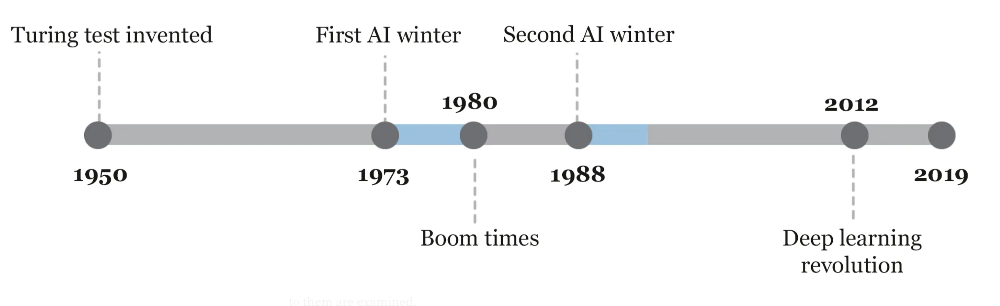

In [25]:
display(Image(filename='../images/AI_Winter.png', width=1024))

## XOR mit Layern

In [26]:
import plotly.graph_objects as go
import numpy as np

def create_neural_net_plotly(n_inputs=3, n_hidden=4, n_outputs=2):
    # Positionen der Neuronen
    layers = [n_inputs, n_hidden, n_outputs]
    layer_spacing = 1
    neuron_spacing = 1
    
    # Knoten erstellen
    nodes_x = []
    nodes_y = []
    nodes_text = []
    nodes_color = []
    
    for i, layer_size in enumerate(layers):
        for j in range(layer_size):
            nodes_x.append(i * layer_spacing)
            nodes_y.append(j * neuron_spacing - (layer_size-1) * neuron_spacing/2)
            nodes_text.append(f'Layer {i}, Neuron {j}')
            nodes_color.append(['lightblue', 'lightgreen', 'salmon'][i])
    
    # Kanten erstellen
    edges_x = []
    edges_y = []
    
    node_indices = np.cumsum([0] + layers)
    
    for i in range(len(layers)-1):
        for j in range(layers[i]):
            for k in range(layers[i+1]):
                start_idx = node_indices[i] + j
                end_idx = node_indices[i+1] + k
                edges_x.extend([nodes_x[start_idx], nodes_x[end_idx], None])
                edges_y.extend([nodes_y[start_idx], nodes_y[end_idx], None])
    
    # Plot erstellen
    fig = go.Figure()
    
    # Kanten hinzufügen
    fig.add_trace(go.Scatter(
        x=edges_x,
        y=edges_y,
        mode='lines',
        line=dict(color='gray', width=0.5),
        hoverinfo='none'
    ))
    
    # Knoten hinzufügen
    fig.add_trace(go.Scatter(
        x=nodes_x,
        y=nodes_y,
        mode='markers+text',
        marker=dict(
            size=30,
            color=nodes_color,
            line=dict(color='black', width=1)
        ),
        text=nodes_text,
        hoverinfo='text'
    ))
    
    # Layout anpassen
    fig.update_layout(
        title='Neuronales Netzwerk',
        showlegend=False,
        plot_bgcolor='white',
        height=600,
        width=800,
        xaxis=dict(
            showgrid=False,
            zeroline=False,
            showticklabels=False
        ),
        yaxis=dict(
            showgrid=False,
            zeroline=False,
            showticklabels=False
        )
    )
    
    return fig



In [27]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

# Create figure with subplot
fig = go.Figure()

# XOR Datenpunkte
x0_xor = [0, 0, 1, 1]
x1_xor = [0, 1, 0, 1]
y_xor = [0, 1, 1, 0]
colors_xor = ['blue' if yi == 0 else 'red' for yi in y_xor]

# Datenpunkte hinzufügen
fig.add_trace(
    go.Scatter(
        x=x0_xor,
        y=x1_xor,
        mode='markers+text',
        marker=dict(
            size=15,
            color=colors_xor,
            symbol='circle',
            line=dict(color='black', width=1)
        ),
        text=['y=0', 'y=1', 'y=1', 'y=0'],
        textposition="top center",
        name='XOR Punkte',
        showlegend=False
    )
)

# Erste Trennlinie: x = 0.5
x_line1 = np.array([0.5, 0.5])
y_line1 = np.array([-0.5, 1.5])

# Zweite Trennlinie: y = 0.5
x_line2 = np.array([-0.5, 1.5])
y_line2 = np.array([0.5, 0.5])

# Trennlinien hinzufügen
fig.add_trace(
    go.Scatter(
        x=x_line1,
        y=y_line1,
        mode='lines',
        line=dict(color='green', dash='dash', width=2),
        name='Trennlinie 1: x = 0.5'
    )
)

fig.add_trace(
    go.Scatter(
        x=x_line2,
        y=y_line2,
        mode='lines',
        line=dict(color='orange', dash='dash', width=2),
        name='Trennlinie 2: y = 0.5'
    )
)

# Beschriftungen für die Regionen
fig.add_annotation(
    x=0.25, y=0.25,
    text="Region 1<br>OUT: 0",
    showarrow=False,
    bgcolor="white"
)
fig.add_annotation(
    x=0.75, y=0.75,
    text="Region 2<br>OUT: 0",
    showarrow=False,
    bgcolor="white"
)
fig.add_annotation(
    x=0.25, y=0.75,
    text="Region 3<br>OUT: 1",
    showarrow=False,
    bgcolor="white"
)
fig.add_annotation(
    x=0.75, y=0.25,
    text="Region 4<br>OUT: 1",
    showarrow=False,
    bgcolor="white"
)

# Formel hinzufügen
fig.add_annotation(
    x=0.5, y=-0.3,
    text="Neuron 1: x - 0.5 = 0<br>Neuron 2: y - 0.5 = 0",
    showarrow=False,
    bgcolor="white",
    bordercolor="black",
    borderwidth=1
)

# Layout aktualisieren
fig.update_layout(
    title_text="XOR-Problem: Lösung mit zwei Trennlinien",
    height=600,
    width=800,
    showlegend=True,
    plot_bgcolor='white',
    xaxis=dict(
        range=[-0.5, 1.5],
        title="x",
        gridcolor='lightgrey',
        gridwidth=1,
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='black'
    ),
    yaxis=dict(
        range=[-0.5, 1.5],
        title="y",
        gridcolor='lightgrey',
        gridwidth=1,
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='black'
    )
)

fig.show()

## Layer FTW

In [66]:
fig = create_neural_net_plotly(2, 2, 1)
fig.show()

In [67]:
import plotly.graph_objects as go
import numpy as np
import base64
from PIL import Image
import io

def img_to_base64(img_path):
    with open(img_path, 'rb') as f:
        encoded = base64.b64encode(f.read()).decode('utf-8')
    return f'data:image/png;base64,{encoded}'

In [68]:
def create_neural_net_plotly_with_images(n_inputs=3, n_hidden=4, n_outputs=3, input_img_path=None, output_img_paths=None):
   fig = create_neural_net_plotly(n_inputs, n_hidden, n_outputs)
   
   if input_img_path:
       fig.add_layout_image(dict(
           source=img_to_base64(input_img_path),
           x=0.05,
           y=0.5,
           sizex=0.25,  # größer
           sizey=0.25,  # größer
           xref="paper",
           yref="paper",
           xanchor="right",
           yanchor="middle"
       ))
       
       # Gitter
       grid_lines = []
       n_grid = 5
       for i in range(n_grid + 1):
           grid_lines.append(dict(
               type="line",
               x0=-0.075, x1=0.05,  # angepasst an Bildgröße
               y0=0.375 + i * 0.25/n_grid,  # angepasst
               y1=0.375 + i * 0.25/n_grid,  # angepasst
               line=dict(color="green", width=4),  # grün und dicker
               xref="paper", yref="paper"
           ))
           grid_lines.append(dict(
               type="line",
               x0=-0.075 + i * 0.125/n_grid,  # angepasst
               x1=-0.075 + i * 0.125/n_grid,  # angepasst
               y0=0.375, y1=0.625,  # angepasst
               line=dict(color="green", width=4),  # grün und dicker
               xref="paper", yref="paper"
           ))
       
       fig.update_layout(shapes=grid_lines)
   
   if output_img_paths:
       y_positions = [0.8, 0.5, 0.2]
       for img_path, y in zip(output_img_paths, y_positions):
           fig.add_layout_image(dict(
               source=img_to_base64(img_path),
               x=1, y=y, sizex=0.15, sizey=0.15,
               xref="paper", yref="paper",
               xanchor="left", yanchor="middle"
           ))
   
   fig.update_layout(width=1000, height=600)
   return fig

In [69]:
import os

# Basis-Pfad festlegen
IMAGE_DIR = "../images"

# Bilder laden
input_img = os.path.join(IMAGE_DIR, "cat.png")
output_imgs = [
   os.path.join(IMAGE_DIR, img) for img in 
   ["cat_icon.png", "ant_icon.png", "frog_icon.png"]
]

# Visualisierung erstellen
fig = create_neural_net_plotly_with_images(
   input_img_path=input_img,
   output_img_paths=output_imgs
)
fig.show()

## Example: UNET

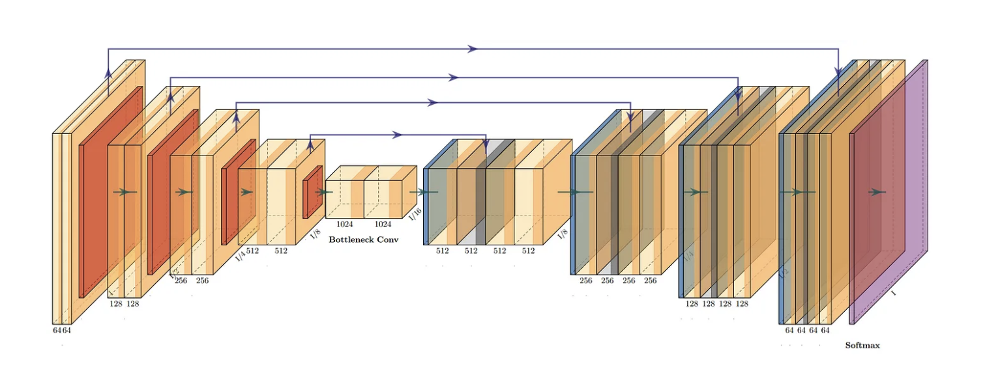

In [73]:
# https://pub.towardsai.net/creating-stunning-neural-network-visualizations-with-chatgpt-and-plotneuralnet-adab37589e5

display(Image(filename='../images/UNET.png', width=meme_width*2))

## TLDR: Layers FTW

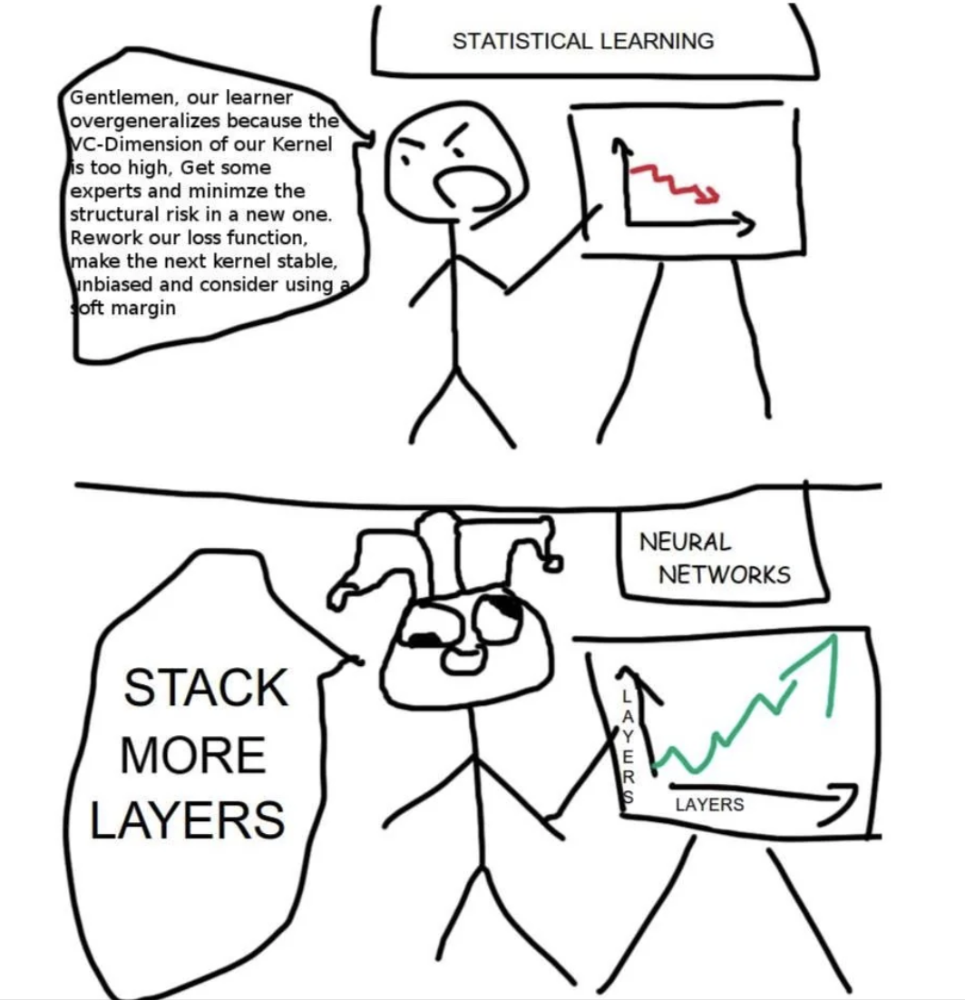

In [71]:
from IPython.display import Image, display
meme_width=600

display(Image(filename='../images/Layers.png', width=meme_width))

# 1.4 - Wie lernen KI im Detail?



## Backpropagation
- üblicherweise werden NUR die Gewichte gelernt, der Rest bleibt fix
- Fehlerfunktion
- Daten in Batches gefüttert
- "Einmal alle Daten durch" entspricht einer Epoche

In [81]:
import plotly.graph_objects as go
import numpy as np

# Konstanten
NODE_SIZE = dict(
   input=50,
   neuron=70,
   output=50
)
X_POSITIONS = dict(
   inputs=-2,
   neuron=0,
   output=2
)
COLORS = dict(
   input='rgba(173, 216, 230, 0.7)',
   neuron='rgba(144, 238, 144, 0.7)',
   output='rgba(250, 128, 114, 0.7)',
   lines='rgba(128, 128, 128, 0.4)',
   lines_updated='rgba(255, 0, 0, 0.4)',
   bias='rgba(255, 218, 185, 0.7)'
)

fig = go.Figure()

# Input Neuronen (2 Inputs + Bias)
input_y = [-1, 0, 1]

# Input Neuronen
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['inputs']], 
   y=[input_y[0]],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'],
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='Uhrzeit<br>x1=0.58',  # Zeilenumbruch mit <br>
   textposition='middle left',
   name='Input'
))

fig.add_trace(go.Scatter(
   x=[X_POSITIONS['inputs']], 
   y=[input_y[1]],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'],
       color=COLORS['input'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='Schlafstunden<br>x2=0.7',
   textposition='middle left',
   showlegend=False
))

# Bias Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['inputs']], 
   y=[input_y[2]],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['input'],
       color=COLORS['bias'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='bias=1.0',
   textposition='middle left',
   name='Bias'
))

# Neuron
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['neuron'],
       color=COLORS['neuron'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='ReLU<br>z=0.15',
   textposition='middle right',
   name='Neuron'
))

# Output
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['output']], 
   y=[0],
   mode='markers+text',
   marker=dict(
       size=NODE_SIZE['output'],
       color=COLORS['output'],
       line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
   ),
   text='Wachheit<br>y=0.15<br>(target=0.8)',
   textposition='middle right',
   name='Output'
))

# Verbindungen und Gewichte
weights = ['0.06', '0.175', '-1.47']
new_weights = ['0.072', '0.191', '-1.45']

for i, (y, w, w_new) in enumerate(zip(input_y, weights, new_weights)):
   x_mid = (X_POSITIONS['inputs'] + X_POSITIONS['neuron']) / 2
   y_mid = (y + 0) / 2
   
   # Alte Gewichte (grau)
   fig.add_trace(go.Scatter(
       x=[X_POSITIONS['inputs']+0.2, X_POSITIONS['neuron']-0.2],
       y=[y, 0],
       mode='lines',
       line=dict(color=COLORS['lines'], width=2),
       name='Alte Gewichte' if i == 0 else None,
       showlegend=i == 0
   ))
   
   # Neue Gewichte (rot)
   fig.add_trace(go.Scatter(
       x=[X_POSITIONS['inputs']+0.2, X_POSITIONS['neuron']-0.2],
       y=[y+0.1, 0.1],
       mode='lines',
       line=dict(color=COLORS['lines_updated'], width=2),
       name='Neue Gewichte' if i == 0 else None,
       showlegend=i == 0
   ))
   
   # Gewichte beschriften - mit mehr Abstand
   if i == 0:  # Unteres Gewicht (w1)
      y_offset = -0.3
   elif i == 1:  # Mittleres Gewicht (w2)
      y_offset = 0
   else:  # Oberes Gewicht (w3)
      y_offset = 0.3
   
   # Altes Gewicht
   fig.add_trace(go.Scatter(
      x=[x_mid-0.2],
      y=[y_mid+y_offset],
      mode='text',
      text=f'w{i+1}={w}',
      textposition='middle right',
      showlegend=False
   ))
   
   # Neues Gewicht - noch weiter versetzt
   fig.add_trace(go.Scatter(
      x=[x_mid+0.2],
      y=[y_mid+y_offset+0.2],  # Größerer vertikaler Abstand zum alten Gewicht
      text=f'w{i+1}_new={w_new}',
      mode='text',
      textposition='middle left',
      showlegend=False
   ))

# Verbindung zum Output
fig.add_trace(go.Scatter(
   x=[X_POSITIONS['neuron']+0.2, X_POSITIONS['output']-0.2],
   y=[0, 0],
   mode='lines',
   line=dict(color=COLORS['lines'], width=2),
   showlegend=False
))

# Lernschritt-Formel
formula = 'Lernschritt mit Rate α=0.1: w_new = w - α × (y-target) × input'

fig.add_annotation(
   x=X_POSITIONS['neuron'],
   y=2,
   text=formula,
   showarrow=False,
   font=dict(size=14),
   bgcolor='rgba(255, 255, 255, 0.9)',
   bordercolor='rgba(0, 0, 0, 0.3)',
   borderwidth=1,
   borderpad=10
)

# Layout
fig.update_layout(
   title=dict(
       text='Neuron zur Wachheitsvorhersage - Gewichtsupdate',
       x=0.5,
       y=0.95,
       font=dict(size=16)
   ),
   showlegend=True,
   xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
   yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
   plot_bgcolor='white',
   width=1000,
   height=600,
   margin=dict(t=100, b=50)
)

fig.show()

## Hyperparameter

- Architektur/Struktur (Anzahl der Layer, Neuronen pro Layer)
- Aktivierungsfunktionen
- Lernrate
- Loss-Funktion
- Optimierungsalgorithmus

## Dropout Layer

In [83]:
import plotly.graph_objects as go
import numpy as np

# Konstanten
NODE_SIZE = dict(
    input=50,
    hidden=70,
    output=50
)
X_POSITIONS = dict(
    inputs=-2,
    hidden=0,
    output=2
)
COLORS = dict(
    active='rgba(144, 238, 144, 0.7)',  # Grün für aktive Neuronen
    inactive='rgba(211, 211, 211, 0.3)', # Grau für inaktive Neuronen
    input='rgba(173, 216, 230, 0.7)',    # Blau für Input
    output='rgba(250, 128, 114, 0.7)',   # Rot für Output
    lines='rgba(128, 128, 128, 0.4)',    # Grau für Verbindungen
    lines_inactive='rgba(128, 128, 128, 0.1)' # Hellgrau für inaktive Verbindungen
)

fig = go.Figure()

# Input Layer (3 Neuronen)
input_y = [-1, 0, 1]
for i, y in enumerate(input_y):
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['inputs']], 
        y=[y],
        mode='markers+text',
        marker=dict(
            size=NODE_SIZE['input'],
            color=COLORS['input'],
            line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
        ),
        text=f'x{i+1}',
        textposition='middle left',
        name='Input' if i == 0 else None,
        showlegend=i == 0
    ))

# Hidden Layer (4 Neuronen, 2 deaktiviert)
hidden_y = [-1.5, -0.5, 0.5, 1.5]
active_neurons = [True, False, True, False]  # Welche Neuronen sind aktiv
for i, (y, active) in enumerate(zip(hidden_y, active_neurons)):
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['hidden']], 
        y=[y],
        mode='markers+text',
        marker=dict(
            size=NODE_SIZE['hidden'],
            color=COLORS['active'] if active else COLORS['inactive'],
            line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
        ),
        text=f'h{i+1}',
        textposition='middle right',
        name='Aktives Neuron' if i == 0 else ('Inaktives Neuron' if i == 1 else None),
        showlegend=i < 2
    ))

# Output Layer (1 Neuron)
fig.add_trace(go.Scatter(
    x=[X_POSITIONS['output']], 
    y=[0],
    mode='markers+text',
    marker=dict(
        size=NODE_SIZE['output'],
        color=COLORS['output'],
        line=dict(color='rgba(70, 70, 70, 0.8)', width=1)
    ),
    text='y',
    textposition='middle right',
    name='Output'
))

# Verbindungen zeichnen
# Input zu Hidden
for i, y1 in enumerate(input_y):
    for j, (y2, active) in enumerate(zip(hidden_y, active_neurons)):
        fig.add_trace(go.Scatter(
            x=[X_POSITIONS['inputs']+0.2, X_POSITIONS['hidden']-0.2],
            y=[y1, y2],
            mode='lines',
            line=dict(
                color=COLORS['lines'] if active else COLORS['lines_inactive'],
                width=1
            ),
            showlegend=False
        ))

# Hidden zu Output
for i, (y, active) in enumerate(zip(hidden_y, active_neurons)):
    fig.add_trace(go.Scatter(
        x=[X_POSITIONS['hidden']+0.2, X_POSITIONS['output']-0.2],
        y=[y, 0],
        mode='lines',
        line=dict(
            color=COLORS['lines'] if active else COLORS['lines_inactive'],
            width=1
        ),
        showlegend=False
    ))

# Titel und Formel für Dropout
fig.add_annotation(
    x=X_POSITIONS['hidden'],
    y=2.5,
    text='Dropout (p=0.5): Jedes Neuron wird mit 50% Wahrscheinlichkeit deaktiviert',
    showarrow=False,
    font=dict(size=14),
    bgcolor='rgba(255, 255, 255, 0.9)',
    bordercolor='rgba(0, 0, 0, 0.3)',
    borderwidth=1,
    borderpad=10
)

# Layout
fig.update_layout(
    title=dict(
        text='Neuronales Netz mit Dropout',
        x=0.5,
        y=0.95,
        font=dict(size=16)
    ),
    showlegend=True,
    xaxis=dict(showticklabels=False, range=[-3.5, 3.5]),
    yaxis=dict(showticklabels=False, range=[-2.5, 3.5]),
    plot_bgcolor='white',
    width=1000,
    height=600,
    margin=dict(t=100, b=50)
)

fig.show()

## Daten als Basis für alles

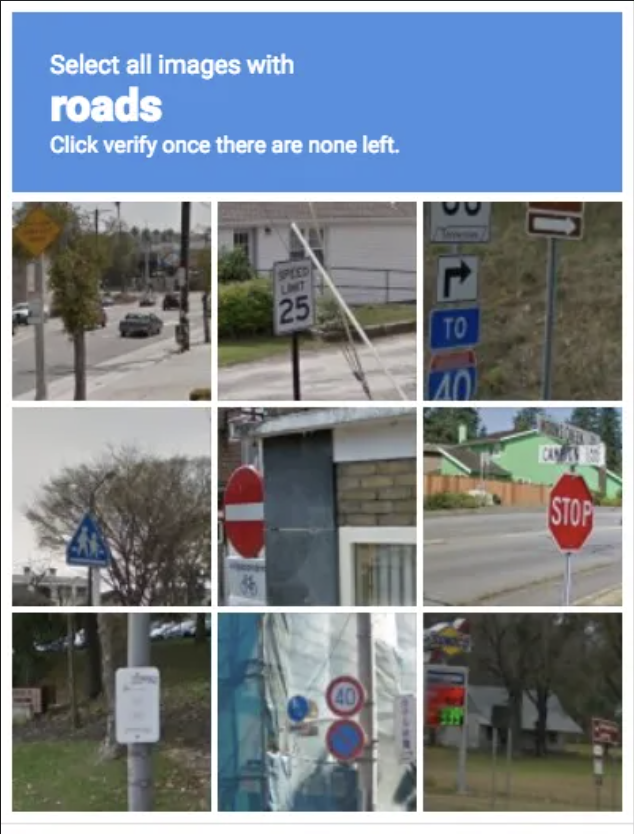

In [57]:
display(Image(filename='../images/Im_not_a_robot.png', width=meme_width))

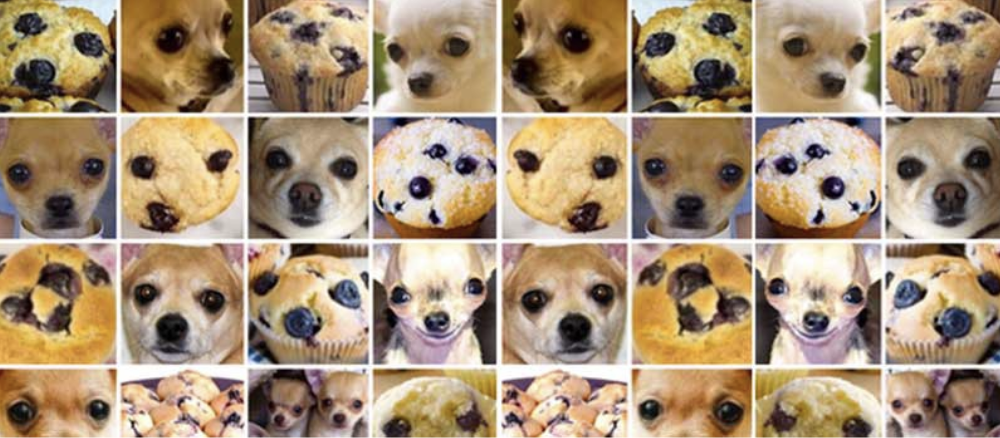

In [97]:
display(Image(filename='../images/Chihuahua_or_muffin.png', width=meme_width))